## Setting Up The Environment

In [1]:
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import nltk 
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import re
print("Tensorflow Version",tf.__version__)
from keras.models import load_model
import os
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.sentiment import SentimentIntensityAnalyzer
from tqdm.notebook import tqdm
import sentencepiece
import pandas as pd
from tqdm import tqdm
from scipy.special import softmax
import warnings
warnings.filterwarnings("ignore")


from transformers import AutoModelForSequenceClassification
from transformers import TFAutoModelForSequenceClassification
from transformers import AutoTokenizer, AutoConfig
import numpy as np
from scipy.special import softmax


from tqdm import tqdm
import numpy as np
import pandas as pd
from transformers import AutoTokenizer, AutoModel
import torch


import pandas as pd
import plotly.express as px
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output



import ipywidgets as widgets
from IPython.display import display



import pandas as pd
from tqdm import tqdm
from scipy.special import softmax
from tabulate import tabulate

import pyfiglet

[nltk_data] Downloading package stopwords to C:\Users\AKSHAY KUMAR
[nltk_data]     DHAR\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Tensorflow Version 2.13.0


## initializing all th efunction

In [2]:


stop_words = stopwords.words('english')
stemmer = SnowballStemmer('english')

# Regular expression pattern to match mentions
mention_pattern = r'@[\w\d_]+'

# Function to remove mentions from a comment
def remove_mentions(comment):
    return re.sub(mention_pattern, '', comment)





text_cleaning_re = "@\S+|https?:\S+|http?:\S|[^A-Za-z0-9]+"

def preprocess(text, stem=False):
  text = re.sub(text_cleaning_re, ' ', str(text).lower()).strip()
  tokens = []
  for token in text.split():
    if token not in stop_words:
      if stem:
        tokens.append(stemmer.stem(token))
      else:
        tokens.append(token)
  return " ".join(tokens)




def preprocess1(text):
    new_text = []
    for t in text.split(" "):
        t = '@user' if t.startswith('@') and len(t) > 1 else t
        t = 'http' if t.startswith('http') else t
        new_text.append(t)
    return " ".join(new_text)


In [3]:

# Folder containing CSV files
folder_path = "D:\\internship\\data\\Instagram\\Maisie Peters"

# Get a list of all files in the folder
file_list = os.listdir(folder_path)

# Filter out only CSV files
csv_files = [file for file in file_list if file.endswith('.csv')]

# Initialize an empty list to store DataFrames
dfs = []

# Loop through each CSV file, read its content, and store in the list of DataFrames
for csv_file in csv_files:
    csv_file_path = os.path.join(folder_path, csv_file)
    
    # Read the CSV file without headers and store in DataFrame
    df = pd.read_csv(csv_file_path, header=None)
    
    # Append the DataFrame to the list
    dfs.append(df)

# Concatenate the list of DataFrames into a single merged DataFrame
merged_df_insta = pd.concat(dfs, ignore_index=True)

# Use the first row as the column headers
merged_df_insta.columns = merged_df_insta.iloc[0]

# Drop the first row (header row) as it's now used as column names
merged_df_insta = merged_df_insta[1:]

# Reset the index of the merged DataFrame
merged_df_insta.reset_index(drop=True, inplace=True)

# Display the merged DataFrame
merged_df_insta




#data cleaning



#renaming coloumns 
new_column_names = {
    '="Comment Text"': 'Comment Text',
    '="Date"': 'Date',
    '="Username"':'Username',
    '="User Id"':'User Id'
    
}
merged_df_insta.rename(columns=new_column_names, inplace=True)

selected_columns = ['User Id','Username','Comment Text','Date']
merged_df_insta=merged_df_insta[selected_columns]


#Formating the User Id,Username and Comment text coloumn 
merged_df_insta['Comment Text'] = merged_df_insta['Comment Text'].str.lstrip('="').str.rstrip('"')
merged_df_insta['User Id'] = merged_df_insta['User Id'].str.lstrip('="').str.rstrip('"')
merged_df_insta['Username'] = merged_df_insta['Username'].str.lstrip('="').str.rstrip('"')
merged_df_insta['Date'] = merged_df_insta['Date'].str.lstrip('="').str.rstrip('"')
#Formating the Data coloumn. 
merged_df_insta = merged_df_insta[merged_df_insta['Date'] != 'Date']
merged_df_insta['Date'] = pd.to_datetime(merged_df_insta['Date'], format="%m/%d/%Y, %I:%M:%S %p")
merged_df_insta['Date'] = merged_df_insta['Date'].dt.strftime('%Y-%m-%d %H:%M')
# merged_df_insta
 

In [4]:
merged_df_insta
desired_username= 'maisiehpeters'
merged_df_insta_with_reply = merged_df_insta[merged_df_insta['Username'] == desired_username]
merged_df_insta_without_reply=merged_df_insta[merged_df_insta['Username'] != desired_username]


In [5]:
# Folder containing CSV files
folder_path ="D:\\internship\\data\\Facebook\\Maisie Peters"

# Get a list of all files in the folder
file_list = os.listdir(folder_path)

# Filter out only CSV files
csv_files = [file for file in file_list if file.endswith('.csv')]

# Initialize an empty list to store DataFrames
dfs = []

# Loop through each CSV file, read its content, and store in the list of DataFrames
for csv_file in csv_files:
    csv_file_path = os.path.join(folder_path, csv_file)
    df = pd.read_csv(csv_file_path)
    dfs.append(df)

# Concatenate the list of DataFrames into a single merged DataFrame
merged_df_fb = pd.concat(dfs, ignore_index=True)


# data cleaning



#renaming the coloumns 
new_column_names = {
    'Content': 'Comment Text',
    'CommentAt': 'Date',
    'UserId': 'User Id',
    'Author': 'Username'
}
merged_df_fb.rename(columns=new_column_names, inplace=True)

selected_columns = ['User Id','Username','Comment Text','Date']
merged_df_fb=merged_df_fb[selected_columns]
#Formating the  date coloumn 
merged_df_fb
merged_df_fb['Date'] = pd.to_datetime(merged_df_fb['Date'], format='%m/%d/%Y %I:%M %p')
merged_df_fb['Date'] = merged_df_fb['Date'].dt.strftime('%Y-%m-%d %H:%M')
merged_df_fb

,User Id,Username,Comment Text,Date
0,5.703289e+08,Fiona Woods,"You are so lucky! That is a life goal for me, ...",2023-03-16 18:31
1,5.693352e+08,Leah Bayfield,Love following your adventures,2023-03-16 16:40
2,1.444857e+09,Maye Pansoy,❤️🥰,2023-03-16 15:21
3,1.000001e+14,Jacqueline Rance,"Maisie, let us put up a photo of you at Steyni...",2023-03-16 20:11
4,1.000533e+14,Apriliawan Edvan,"Dear Maisie Peters, Hello I'm Edvan from Jakar...",2023-03-16 20:09
...,...,...,...,...
3518,1.000810e+14,Abdo Kelani,🤣🤣🤣🤣🤣💔🤣🤣🤣👫🤣🤣🤣🤣🤣,2023-01-09 01:55
3519,1.000010e+14,Codi Ryan,Olivia Moloney girl wake up! 😍,2023-01-05 20:41
3520,1.000099e+14,Lucas O'Heyze,No thanks,2023-01-12 17:38
3521,1.000161e+14,Laurence Sims,Just another pop singer.,2023-01-10 14:46


In [6]:
merged_df_fb
desired_username_fb= 'Maisie Peters'
merged_df_fb_with_reply = merged_df_fb[merged_df_fb['Username'] == desired_username_fb]
merged_df_fb_without_reply=merged_df_fb[merged_df_fb['Username'] != desired_username_fb]


In [7]:
merged_df = pd.concat([merged_df_insta, merged_df_fb], ignore_index=True)
merged_df = merged_df.sort_values(by='Date')
merged_df


,User Id,Username,Comment Text,Date
53039,100003798675549.0,Maxi Martinez Gn'r,Loving you is not enough :'),2021-11-23 17:38
53038,100026138243318.0,Glendel Lou A. Cahilig,I love you so much!,2021-11-23 17:39
53044,100022482528534.0,Aidan Charles Prince,Queen Mazzie ❤️,2021-11-23 17:50
53045,100001121949335.0,Sergio E. Medina,My favorite album of all time,2021-11-23 18:07
53036,626352392.0,Allie Cox,"Well deserved, thank you for the fantastic music",2021-11-23 18:07
...,...,...,...,...
53136,521545646.0,Peter Williams,The songs are so unique and have had it in con...,2023-07-10 11:50
53143,683437529.0,Brooklyn Crossley,It’s an amazing album,2023-07-10 12:04
53140,100003801549206.0,Ellen Hoban Macleod,the good witch is such a beautiful album 🩷 v p...,2023-07-10 12:18
53139,100049079232678.0,Todd Farnsworth,PAPERBACK NORTH STARS! Maisie you are amazing.,2023-07-10 12:36


In [8]:
merged_df['Comment Text'] = merged_df['Comment Text'].astype(str)
# # Name of the column containing comment text
# comment_column = 'Comment Text'

# Apply the function to the comment column
merged_df['Comment Text'] = merged_df['Comment Text'].apply(remove_mentions)
df=merged_df
df

,User Id,Username,Comment Text,Date
53039,100003798675549.0,Maxi Martinez Gn'r,Loving you is not enough :'),2021-11-23 17:38
53038,100026138243318.0,Glendel Lou A. Cahilig,I love you so much!,2021-11-23 17:39
53044,100022482528534.0,Aidan Charles Prince,Queen Mazzie ❤️,2021-11-23 17:50
53045,100001121949335.0,Sergio E. Medina,My favorite album of all time,2021-11-23 18:07
53036,626352392.0,Allie Cox,"Well deserved, thank you for the fantastic music",2021-11-23 18:07
...,...,...,...,...
53136,521545646.0,Peter Williams,The songs are so unique and have had it in con...,2023-07-10 11:50
53143,683437529.0,Brooklyn Crossley,It’s an amazing album,2023-07-10 12:04
53140,100003801549206.0,Ellen Hoban Macleod,the good witch is such a beautiful album 🩷 v p...,2023-07-10 12:18
53139,100049079232678.0,Todd Farnsworth,PAPERBACK NORTH STARS! Maisie you are amazing.,2023-07-10 12:36


## vader approach on the aggreated dataset (insta and fb)

In [9]:
Sentiment = SentimentIntensityAnalyzer()
sentiment_scores_V = []

for index, row in tqdm(df.iterrows(), total=len(df)):
    text = row[2]  
    sentiment_score = Sentiment.polarity_scores(text)
    sentiment_scores_V.append(sentiment_score)

# Create a new DataFrame to store sentiment scores and merge it with the original data
sentiment_df = pd.DataFrame(sentiment_scores_V)
new_column_names = {
    'neg': 'vader_neg',
    'neu': 'vader_neu',
    'pos': 'vader_pos',
    'compound': 'vader_compound',
}
sentiment_df.rename(columns=new_column_names, inplace=True)
data_with_sentiment_VADER  = pd.concat([df, sentiment_df], axis=1)


data_with_sentiment_VADER.isnull().sum()
# print()
data_with_sentiment_VADER=data_with_sentiment_VADER.dropna()

data_with_sentiment_VADER.isnull().sum()
data_with_sentiment_VADER

  0%|          | 0/56050 [00:00<?, ?it/s]

100%|██████████| 56050/56050 [00:06<00:00, 8564.80it/s] 


,User Id,Username,Comment Text,Date,vader_neg,vader_neu,vader_pos,vader_compound
53039,100003798675549.0,Maxi Martinez Gn'r,Loving you is not enough :'),2021-11-23 17:38,0.00,0.313,0.687,0.6580
53038,100026138243318.0,Glendel Lou A. Cahilig,I love you so much!,2021-11-23 17:39,0.00,0.426,0.574,0.8435
53044,100022482528534.0,Aidan Charles Prince,Queen Mazzie ❤️,2021-11-23 17:50,0.00,0.528,0.472,0.6682
53045,100001121949335.0,Sergio E. Medina,My favorite album of all time,2021-11-23 18:07,0.00,0.589,0.411,0.8770
53036,626352392.0,Allie Cox,"Well deserved, thank you for the fantastic music",2021-11-23 18:07,0.00,0.588,0.412,0.6369
...,...,...,...,...,...,...,...,...
53136,521545646.0,Peter Williams,The songs are so unique and have had it in con...,2023-07-10 11:50,0.48,0.520,0.000,-0.4158
53143,683437529.0,Brooklyn Crossley,It’s an amazing album,2023-07-10 12:04,0.00,0.596,0.404,0.5256
53140,100003801549206.0,Ellen Hoban Macleod,the good witch is such a beautiful album 🩷 v p...,2023-07-10 12:18,0.00,0.549,0.451,0.8122
53139,100049079232678.0,Todd Farnsworth,PAPERBACK NORTH STARS! Maisie you are amazing.,2023-07-10 12:36,0.00,1.000,0.000,0.0000


## custome model approach fr analysis 

### load the model

In [10]:
# Load previously trained LSTM Model

from keras.models import load_model

model_path = "C:\\Users\\AKSHAY KUMAR DHAR\\OneDrive - Queen's University Belfast\\model\\save model\\my_model.h5"
pretrained_lstm_model = load_model(model_path)

# summarize model.
pretrained_lstm_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 30)]              0         
                                                                 
 embedding (Embedding)       (None, 30, 300)           87172500  
                                                                 
 spatial_dropout1d (Spatial  (None, 30, 300)           0         
 Dropout1D)                                                      
                                                                 
 conv1d (Conv1D)             (None, 26, 64)            96064     
                                                                 
 bidirectional (Bidirection  (None, 128)               66048     
 al)                                                             
                                                                 
 dense (Dense)               (None, 512)               66048 

In [11]:
df

,User Id,Username,Comment Text,Date
53039,100003798675549.0,Maxi Martinez Gn'r,Loving you is not enough :'),2021-11-23 17:38
53038,100026138243318.0,Glendel Lou A. Cahilig,I love you so much!,2021-11-23 17:39
53044,100022482528534.0,Aidan Charles Prince,Queen Mazzie ❤️,2021-11-23 17:50
53045,100001121949335.0,Sergio E. Medina,My favorite album of all time,2021-11-23 18:07
53036,626352392.0,Allie Cox,"Well deserved, thank you for the fantastic music",2021-11-23 18:07
...,...,...,...,...
53136,521545646.0,Peter Williams,The songs are so unique and have had it in con...,2023-07-10 11:50
53143,683437529.0,Brooklyn Crossley,It’s an amazing album,2023-07-10 12:04
53140,100003801549206.0,Ellen Hoban Macleod,the good witch is such a beautiful album 🩷 v p...,2023-07-10 12:18
53139,100049079232678.0,Todd Farnsworth,PAPERBACK NORTH STARS! Maisie you are amazing.,2023-07-10 12:36


In [12]:
train_data=df['Comment Text']
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_data)
word_index = tokenizer.word_index
vocab_size = len(tokenizer.word_index) + 1
print("Vocabulary Size :", vocab_size)

train_data=df['Comment Text']
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_data)
word_index = tokenizer.word_index
vocab_size = len(tokenizer.word_index) + 1
print("Vocabulary Size :", vocab_size)

commentdata = df
unseen_texts = commentdata['Comment Text'].tolist()
unseen_texts
unseen_texts = commentdata['Comment Text'].apply(lambda x: str(x)).tolist()
unseen_texts


unseen_processed = []
for text in unseen_texts:
  text  = preprocess(text)
  unseen_processed.append(text)
unseen_processed
sequences = tokenizer.texts_to_sequences(unseen_processed)
max_sequence_length =30  # Adjust this based on your training sequence length
padded_sequences = pad_sequences(sequences, maxlen=max_sequence_length) 

predictions_senti = pretrained_lstm_model.predict(padded_sequences)
predictions_senti

def decode_sentiment(score):
    return "Positive" if score >0.4 else "Negative"

y_pred = [decode_sentiment(predictions_senti) for predictions_senti in predictions_senti]
y_pred


print(np.unique(y_pred)) 
print('-------------------------------------------------------------------------')
print(np.unique(predictions_senti)) 


print(y_pred)
print(unseen_processed)
df_y_pred = pd.DataFrame({'Sentiment': y_pred})
df_unseen_texts = pd.DataFrame({'Text': unseen_processed})

result_df = pd.concat([df_unseen_texts, df_y_pred], axis=1)

result_df

Vocabulary Size : 21930
Vocabulary Size : 21930
1752/1752 [==============================] - 8s 5ms/step
['Negative' 'Positive']
-------------------------------------------------------------------------
[0.00122018 0.00152696 0.00183571 ... 0.9963166  0.99684167 0.9979879 ]
['Positive', 'Positive', 'Negative', 'Positive', 'Positive', 'Negative', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Negative', 'Negative', 'Negative', 'Positive', 'Negative', 'Positive', 'Negative', 'Negative', 'Positive', 'Positive', 'Negative', 'Positive', 'Positive', 'Negative', 'Positive', 'Negative', 'Positive', 'Positive', 'Positive', 'Positive', 'Negative', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Positive', 'Negative', 'Positive', 'Negative', 'Negative', 'Negative', 'Positive', 'Negative', 'Positive', 'Positive', 'Positive', 'Positive', 'Negative', 'Negative', 'Negative', 'Positive', 'Negative', 'Positive', 'Negative', 'Neg

,Text,Sentiment
0,loving enough,Positive
1,love much,Positive
2,queen mazzie,Negative
3,favorite album time,Positive
4,well deserved thank fantastic music,Positive
...,...,...
56045,songs unique constant play since launched one ...,Negative
56046,amazing album,Positive
56047,good witch beautiful album v proud x,Negative
56048,paperback north stars maisie amazing,Positive


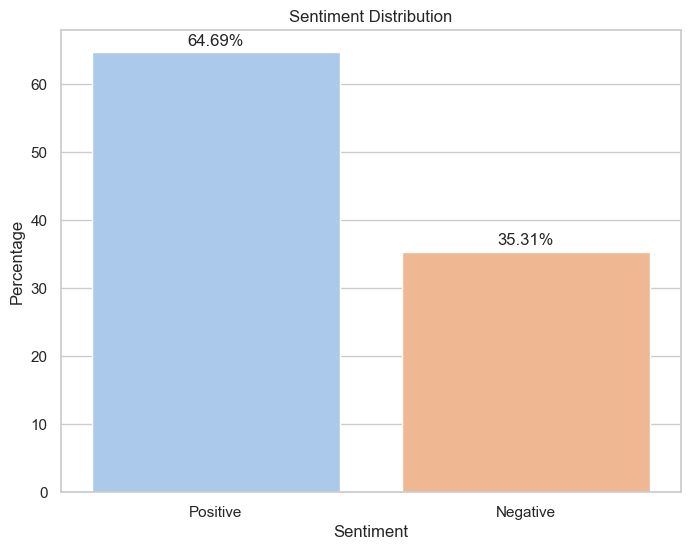

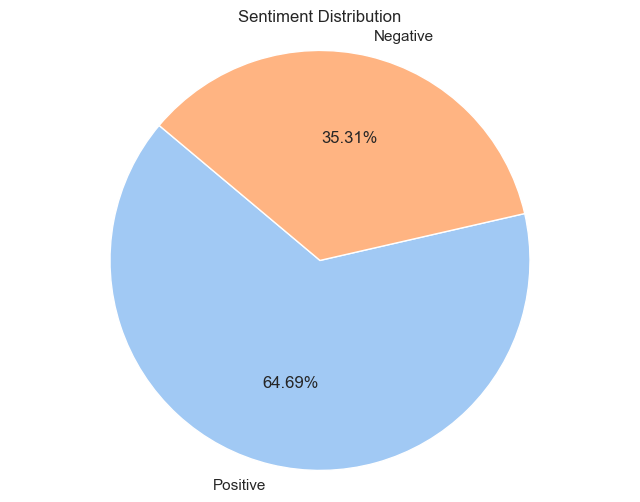

In [13]:
# some visulazization 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sentiment_counts = result_df['Sentiment'].value_counts()
sentiment_counts


#Calculate the percentage of each sentiment
total_samples = len(result_df)
sentiment_percentages = (sentiment_counts / total_samples) * 100


plt.figure(figsize=(8, 6))
sns.set(style="whitegrid")
sns.barplot(x=sentiment_percentages.index, y=sentiment_percentages.values, palette="pastel")

# Add labels and title
plt.xlabel('Sentiment')
plt.ylabel('Percentage')
plt.title('Sentiment Distribution')

# Display percentages on the bars
for index, value in enumerate(sentiment_percentages):
    plt.text(index, value + 1, f'{value:.2f}%', ha='center')

# Show the plot
plt.show()

#----------------------------------------------------------------------------------------------------

# Create a pie chart
plt.figure(figsize=(8, 6))
colors = sns.color_palette('pastel')
plt.pie(sentiment_percentages, labels=sentiment_percentages.index, autopct='%.2f%%', colors=colors, startangle=140)
plt.title('Sentiment Distribution')

# Equal aspect ratio ensures that pie is drawn as a circle.
plt.axis('equal')

# Show the plot
plt.show()

In [14]:
x=result_df[result_df['Sentiment']=='Negative']
x.head(500)

,Text,Sentiment
2,queen mazzie,Negative
5,may force x knew magnificence 3 6 9 would key ...,Negative
11,love songs listen going work gets motivated,Negative
12,love lets found numbers 200m,Negative
13,first listened one songs one final dates love ...,Negative
...,...,...
1290,know screaming song like got blonde hair ex,Negative
1293,omggg yes,Negative
1295,return blonde era song,Negative
1300,next hair color blonde got,Negative


## roberto approach on the aggreated dataset (insta and fb)

In [15]:
torch.backends.cudnn.benchmark = False
MODEL1 = f"cardiffnlp/twitter-roberta-base-sentiment-latest"
tokenizer1 = AutoTokenizer.from_pretrained(MODEL1)
config1 = AutoConfig.from_pretrained(MODEL1)
model1 = AutoModelForSequenceClassification.from_pretrained(MODEL1)

Some weights of the model checkpoint at cardiffnlp/twitter-roberta-base-sentiment-latest were not used when initializing RobertaForSequenceClassification: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [16]:
import pandas as pd
from tqdm import tqdm
from scipy.special import softmax

# Define the sentiment labels
sentiment_labels = ['roberta_neg', 'roberta_neu', 'roberta_pos']

# Initialize an empty list to store the sentiment dictionaries
sentiment_scores_list = []

# Iterate through each text in the 'Comment Text' column
# Iterate through each text in the 'Comment Text' column
for text in tqdm(df['Comment Text'], total=len(df)):
    if isinstance(text, str):  # Check if the value is a string
        try:
            text = preprocess1(text)
            text = preprocess(text)
            encoded_text = tokenizer1(text, return_tensors='pt')
            output = model1(**encoded_text)
            scores = output[0][0].detach().numpy()  # Applying softmax
            scores = softmax(scores)
            scores_dict = {label: score for label, score in zip(sentiment_labels, scores)}
            sentiment_scores_list.append(scores_dict)
        except RuntimeError:
            print(f'Broke for text: {text}')
    else:
        print(f'Skipped non-string value: {text}')
# Convert the list of sentiment dictionaries to a DataFrame
sentiment_scores_df = pd.DataFrame(sentiment_scores_list)

# Concatenate the original DataFrame with the sentiment scores DataFrame
data_with_sentiment_ROBERTA = pd.concat([df, sentiment_scores_df], axis=1)

data_with_sentiment_ROBERTA 

100%|██████████| 56050/56050 [3:10:35<00:00,  4.90it/s]   


,User Id,Username,Comment Text,Date,roberta_neg,roberta_neu,roberta_pos
53039,100003798675549.0,Maxi Martinez Gn'r,Loving you is not enough :'),2021-11-23 17:38,0.004929,0.021422,0.973650
53038,100026138243318.0,Glendel Lou A. Cahilig,I love you so much!,2021-11-23 17:39,0.005098,0.012511,0.982391
53044,100022482528534.0,Aidan Charles Prince,Queen Mazzie ❤️,2021-11-23 17:50,0.009099,0.031109,0.959792
53045,100001121949335.0,Sergio E. Medina,My favorite album of all time,2021-11-23 18:07,0.010890,0.017649,0.971461
53036,626352392.0,Allie Cox,"Well deserved, thank you for the fantastic music",2021-11-23 18:07,0.007622,0.088452,0.903927
...,...,...,...,...,...,...,...
53136,521545646.0,Peter Williams,The songs are so unique and have had it in con...,2023-07-10 11:50,0.329213,0.375282,0.295504
53143,683437529.0,Brooklyn Crossley,It’s an amazing album,2023-07-10 12:04,0.013072,0.103368,0.883560
53140,100003801549206.0,Ellen Hoban Macleod,the good witch is such a beautiful album 🩷 v p...,2023-07-10 12:18,0.004570,0.021185,0.974245
53139,100049079232678.0,Todd Farnsworth,PAPERBACK NORTH STARS! Maisie you are amazing.,2023-07-10 12:36,0.006933,0.193981,0.799085


## visulization and coustome function to determine lables and bit of data ceaning ( on the aggreated dataset (insta and fb))

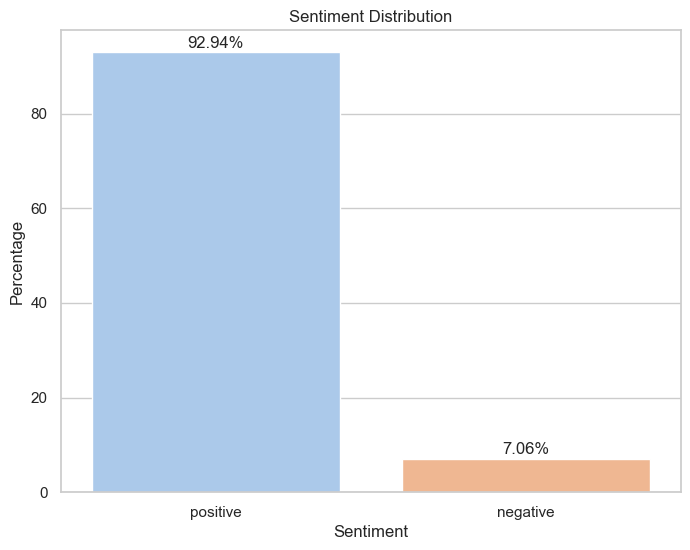

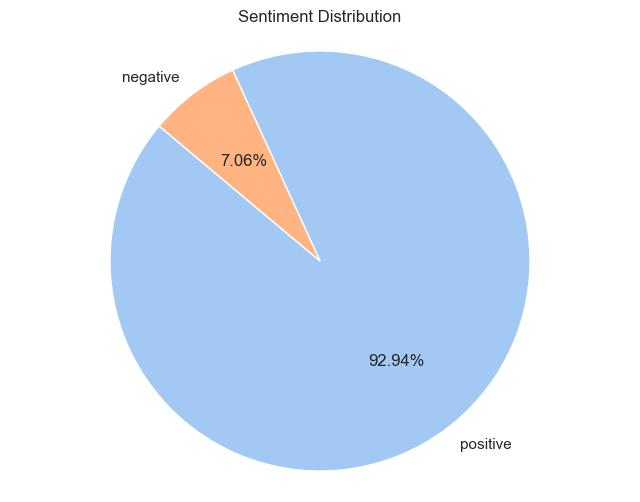

In [17]:
data_with_sentiment_ROBERTA
data_with_sentiment_ROBERTA.isnull().sum()
print()
data_with_sentiment_ROBERTA=data_with_sentiment_ROBERTA.dropna()

data_with_sentiment_ROBERTA.isnull().sum()
data_with_sentiment_ROBERTA








# Custom function to determine sentiment label
def get_sentiment(row):
    max_score = max(row['roberta_neg'], row['roberta_neu'], row['roberta_pos'])
    if max_score == row['roberta_neg']:
        return 'negative'
    elif max_score == row['roberta_neu']:
        return 'positive'
    else:
        return 'positive'

# Apply the custom function to create the 'sentiment' column
data_with_sentiment_ROBERTA['sentiment'] = data_with_sentiment_ROBERTA.apply(get_sentiment, axis=1)
selected_columns = ['User Id', 'Username', 'Comment Text', 'Date','sentiment']
sentiment = data_with_sentiment_ROBERTA[selected_columns]
sentiment



# visulization
# some visulazization 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sentiment_counts = sentiment['sentiment'].value_counts()
sentiment_counts


#Calculate the percentage of each sentiment
total_samples = len(sentiment)
sentiment_percentages = (sentiment_counts / total_samples) * 100


plt.figure(figsize=(8, 6))
sns.set(style="whitegrid")
sns.barplot(x=sentiment_percentages.index, y=sentiment_percentages.values, palette="pastel")

# Add labels and title
plt.xlabel('Sentiment')
plt.ylabel('Percentage')
plt.title('Sentiment Distribution')

# Display percentages on the bars
for index, value in enumerate(sentiment_percentages):
    plt.text(index, value + 1, f'{value:.2f}%', ha='center')

# Show the plot
plt.show()

#----------------------------------------------------------------------------------------------------

# Create a pie chart
plt.figure(figsize=(8, 6))
colors = sns.color_palette('pastel')
plt.pie(sentiment_percentages, labels=sentiment_percentages.index, autopct='%.2f%%', colors=colors, startangle=140)
plt.title('Sentiment Distribution')

# Equal aspect ratio ensures that pie is drawn as a circle.
plt.axis('equal')

# Show the plot
plt.show()


## time series visulization on the aggreated data 

In [18]:
data_with_sentiment_ROBERTA.set_index('Date', inplace=True)
data_with_sentiment_ROBERTA.index = pd.to_datetime(data_with_sentiment_ROBERTA.index)


In [19]:




time_plot = data_with_sentiment_ROBERTA[['roberta_pos', 'roberta_neg']]  # Selecting both columns

app = dash.Dash(__name__)

app.layout = html.Div([
    dcc.DatePickerRange(
        id='date-picker-range',
        start_date=time_plot.index.min().date(),
        end_date=time_plot.index.max().date()
    ),
    dcc.Graph(id='time-plot'),
])

@app.callback(
    Output('time-plot', 'figure'),
    [Input('date-picker-range', 'start_date'),
     Input('date-picker-range', 'end_date')]
)
def update_time_plot(start_date, end_date):
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    
    filtered_time_plot = time_plot[(time_plot.index >= start_date) & (time_plot.index <= end_date)]

    fig = px.line(filtered_time_plot, title="Zoomable Time Plot")
    fig.update_xaxes(title_text="Time")
    fig.update_yaxes(title_text="Value")  # Update the y-axis label

    fig.update_layout(
        xaxis_rangeslider_visible=True,
        xaxis_rangeslider_thickness=0.1,
        xaxis_type="date"
    )

    for column in filtered_time_plot.columns:
        fig.add_scatter(x=filtered_time_plot.index, y=filtered_time_plot[column], mode='lines+markers', name=column)

    fig.update_xaxes(rangeselector=dict(
        buttons=list([
            dict(count=1, label="1d", step="day", stepmode="backward"),
            dict(count=7, label="1w", step="day", stepmode="backward"),
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    ),
        rangeslider=dict(visible=True),
        type="date"
    )

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)
    


## emotion classification 

In [20]:
MODEL = f"SamLowe/roberta-base-go_emotions"
tokenizer = AutoTokenizer.from_pretrained(MODEL)
config = AutoConfig.from_pretrained(MODEL)

model = AutoModelForSequenceClassification.from_pretrained(MODEL)

In [22]:
comments = sentiment.iloc[:,2].tolist()
emotion_mapping = {
    0: "admiration",
    1: "amusement",
    2: "anger",
    3: "annoyance",
    4: "approval",
    5: "caring",
    6: "confusion",
    7: "curiosity",
    8: "desire",
    9: "disappointment",
    10: "disapproval",
    11: "disgust",
    12: "embarrassment",
    13: "excitement",
    14: "fear",
    15: "gratitude",
    16: "grief",
    17: "joy",
    18: "love",
    19: "nervousness",
    20: "optimism",
    21: "pride",
    22: "realization",
    23: "relief",
    24: "remorse",
    25: "sadness",
    26: "surprise",
    27: "neutral"
}


from tqdm import tqdm

# Create a list to store the emotion predictions
emotion_predictions = []

# Iterate through the comments and classify emotions
for comment in tqdm(comments, desc="Classifying emotions"):
    inputs = tokenizer(comment, return_tensors="pt", padding="max_length", truncation=True, max_length=128)
    outputs = model(**inputs)
    predicted_emotion = torch.argmax(outputs.logits).item()
    emotion_name = emotion_mapping[predicted_emotion]
    emotion_predictions.append(emotion_name)

# Add the predicted emotion names to the DataFrame
sentiment["predicted_emotion"] = emotion_predictions

 

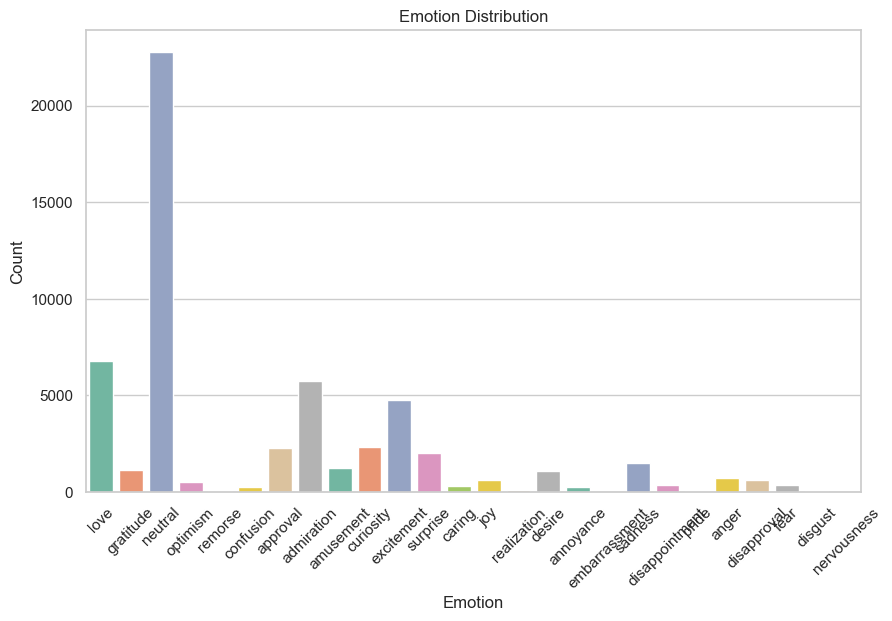

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame with 'emotion' column
plt.figure(figsize=(10, 6))
sns.countplot(data=sentiment, x='predicted_emotion', palette='Set2')
plt.title("Emotion Distribution")
plt.xlabel("Emotion")
plt.ylabel("Count")
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()


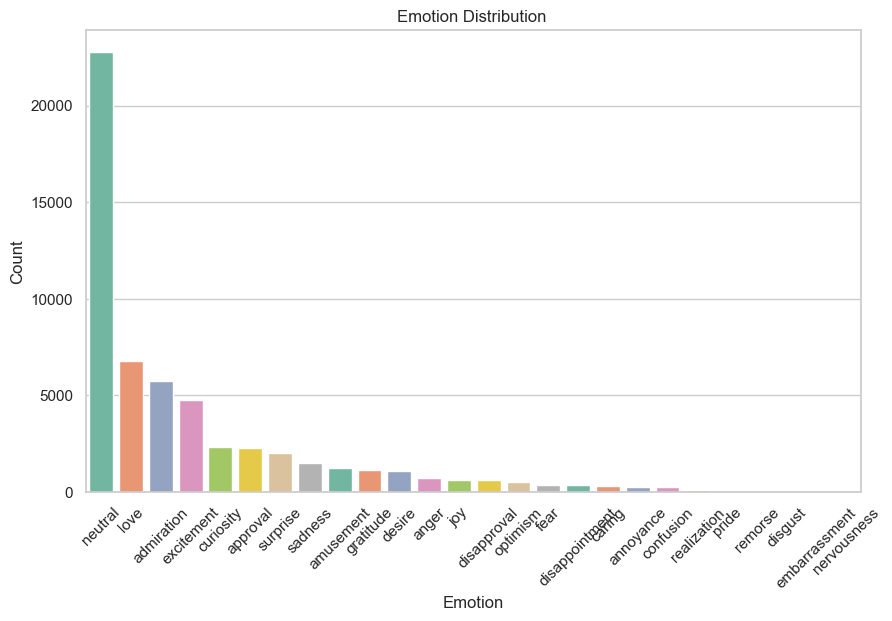

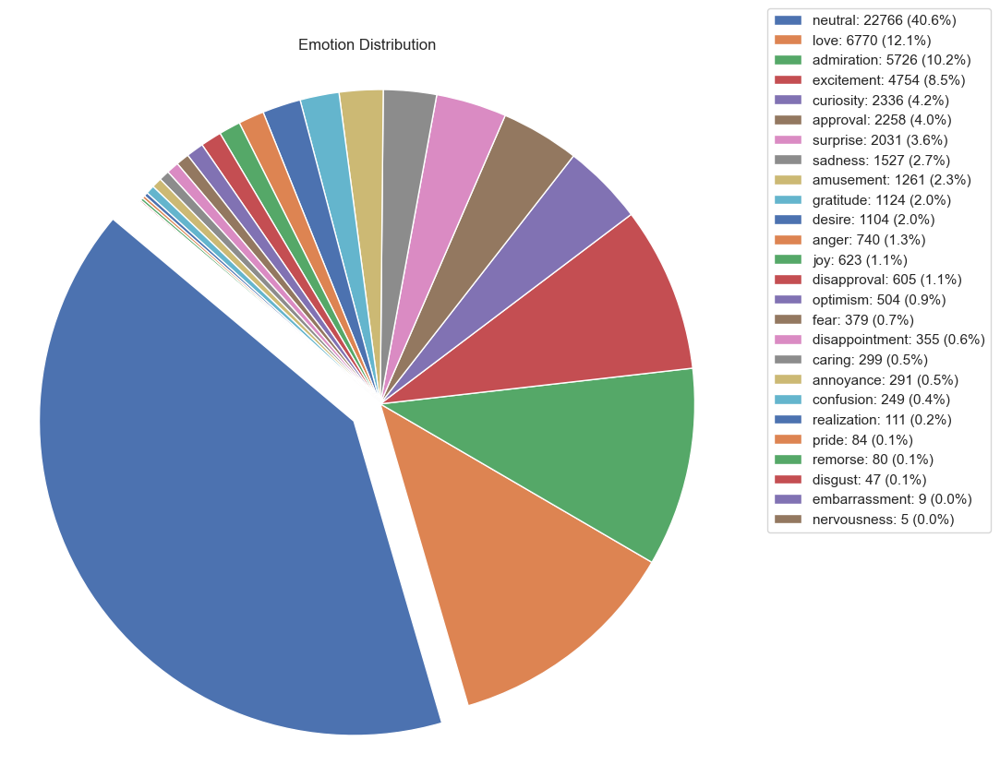

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt

emotion_counts = sentiment['predicted_emotion'].value_counts().reset_index()
emotion_counts.columns = ['predicted_emotion', 'count']
sorted_emotion_counts = emotion_counts.sort_values(by='count',ascending=False)

# Create the countplot with sorted order
plt.figure(figsize=(10, 6))
sns.countplot(data=sentiment, x='predicted_emotion', palette='Set2', order=sorted_emotion_counts['predicted_emotion'])
plt.title("Emotion Distribution ")
plt.xlabel("Emotion")
plt.ylabel("Count")
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()



import matplotlib.pyplot as plt
import numpy as np


emotions_data = sentiment['predicted_emotion']

# Get emotion counts
emotions = emotions_data.value_counts()
emotions = emotions[emotions >= 1]  # Filter out emotions with zero counts

# Explode the first slice (optional)
explode = (0.1,) + (0,) * (len(emotions) - 1)

# Create a pie chart without labels
plt.figure(figsize=(10, 10))
wedges, _, autotexts = plt.pie(emotions, labels=None, autopct='', startangle=140, explode=explode, pctdistance=0.85)

# Calculate the positions for the legend
bbox = (1.05, 0.7)
legend_labels = [f"{emotion}: {count} ({percent:.1f}%)"
                 for emotion, count, percent in zip(emotions.index, emotions, 100.0 * emotions / emotions.sum())]
plt.legend(legend_labels, loc="center left", bbox_to_anchor=bbox)

# Set title
plt.title("Emotion Distribution")

# Equal aspect ratio ensures that pie is drawn as a circle.
plt.axis('equal')

# Add colors next to the pie chart
colors = [w.get_facecolor() for w in wedges]
for at, color in zip(autotexts, colors):
    at.set_text('')  # Remove text from slices
    at.set_color(color)

# Show the pie chart
plt.show()



## Grouping of the comments 

In [8]:
sentiment 
grouped = sentiment.groupby('User Id')['Comment Text'].agg(list).reset_index()        
grouped['num_comments'] = grouped['Comment Text'].apply(len)
print(grouped)

# Iterate through each row of the DataFrame
for index, row in grouped.iterrows():
    user_id = row['User Id']
    comments = row['Comment Text']
    print(f"User ID: {user_id}")
    for comment in comments:
        print(comment)
    print("--------" * 30)  # Adding a separator between users



grouped = grouped.sort_values(by='num_comments', ascending=False)
grouped
grouped['num_comments'].unique()

          User Id                                       Comment Text  \
0      10016564.0                 [OK but WHEN DO WE GET THE SONG?!]   
1      14819452.0                                     [Who are you?]   
2      32804897.0  [This is the best news I could've gotten, afte...   
3      61212847.0                                      [Amanda Lily]   
4      68114333.0                                             [😍, 😍]   
...           ...                                                ...   
17637  9988119620         [@chatsandreacts omg you‘re gonna react 😭]   
17638   998864846  [😍😍😍, But he hasn’t got blonde hair, I want th...   
17639  9990666507                               [we love you MTV!!!]   
17640  9991037117               [Je vous aimes ❤️, Je vous aimes ❤️]   
17641  9996833667                     [pls come to argentina🥺🥺🥺🥺🩵🤍🩵]   

       num_comments  
0                 1  
1                 1  
2                 4  
3                 1  
4                 2  
...

array([818, 417, 289, 288, 264, 263, 243, 242, 235, 187, 186, 175, 168,
       164, 156, 155, 150, 149, 144, 136, 129, 127, 115, 114, 112, 106,
       103, 102,  99,  98,  97,  95,  93,  91,  86,  81,  80,  79,  78,
        76,  75,  74,  73,  71,  70,  67,  66,  64,  63,  62,  61,  60,
        59,  58,  57,  56,  55,  54,  53,  52,  50,  49,  48,  47,  46,
        45,  44,  43,  42,  41,  40,  38,  37,  36,  35,  34,  33,  32,
        31,  30,  29,  28,  27,  26,  25,  24,  23,  22,  21,  20,  19,
        18,  17,  16,  15,  14,  13,  12,  11,  10,   9,   8,   7,   6,
         5,   4,   3,   2,   1], dtype=int64)

In [9]:
df =grouped
min_comments = df['num_comments'].min()
max_comments = df['num_comments'].max()
# Function to normalize comments to the 1-100 range
def normalize_comments(num_comments):
    return ((num_comments - min_comments) / (max_comments - min_comments)) * 99 + 1

# Apply the normalization function to the DataFrame
df['Normalized_Comments_count'] = df['num_comments'].apply(normalize_comments)

# Display the normalized data
df



,User Id,Comment Text,num_comments,Normalized_Comments_count
15522,613916885,"[@shotbyphox no but me with u, @ellen.crombie ...",818,100.000000
12735,48535530525,"[ur so iconic stop, mazzie i just finished fai...",417,51.408813
4084,16379684253,[NOT YOU POSTING THIS WHILE IM CRYING TO YOUR ...,289,35.898409
7636,265402464,"[SLAYY SEE YOU SOON, slay bestie slay, come ba...",288,35.777234
15898,6806140181,"[stop it ur such a slay, i love u 😭, im very p...",264,32.869033
...,...,...,...,...
7513,26049549979,[@caitlin16jjones are u coming with me girly?],1,1.000000
7514,26051838556,[@my_son2.0 must have],1,1.000000
7517,26058640,[@laurabloemendal ❤️❤️❤️],1,1.000000
7518,26064020842,[jhm],1,1.000000


In [15]:
from sklearn.cluster import KMeans

# Assuming df is your DataFrame with 'userid' and 'Normalized_Comments' columns
X = df[['Normalized_Comments_count']]

# Define the number of clusters (K)
n_clusters = 3

# Create a K-Means model
kmeans = KMeans(n_clusters=n_clusters, init='k-means++',random_state=78)

# Fit the model to your data
df['Cluster'] = kmeans.fit_predict(X)

# Map cluster labels to meaningful segment names
cluster_mapping = {
    1: 'Low Contributor- Ambient',
    2: 'High Contributor-Super ',
    0: ' Moderate Contributor - Engaged'
}
df['Contribution_Category'] = df['Cluster'].map(cluster_mapping)

# Display the segmented data
df


,User Id,Comment Text,num_comments,Normalized_Comments_count,Cluster,Contribution_Category
15522,613916885,"[@shotbyphox no but me with u, @ellen.crombie ...",818,100.000000,2,High Contributor-Super
12735,48535530525,"[ur so iconic stop, mazzie i just finished fai...",417,51.408813,2,High Contributor-Super
4084,16379684253,[NOT YOU POSTING THIS WHILE IM CRYING TO YOUR ...,289,35.898409,2,High Contributor-Super
7636,265402464,"[SLAYY SEE YOU SOON, slay bestie slay, come ba...",288,35.777234,2,High Contributor-Super
15898,6806140181,"[stop it ur such a slay, i love u 😭, im very p...",264,32.869033,2,High Contributor-Super
...,...,...,...,...,...,...
7513,26049549979,[@caitlin16jjones are u coming with me girly?],1,1.000000,1,Low Contributor- Ambient
7514,26051838556,[@my_son2.0 must have],1,1.000000,1,Low Contributor- Ambient
7517,26058640,[@laurabloemendal ❤️❤️❤️],1,1.000000,1,Low Contributor- Ambient
7518,26064020842,[jhm],1,1.000000,1,Low Contributor- Ambient


In [19]:
df['Contribution_Category'].value_counts()

df[df['Cluster']==1]

,User Id,Comment Text,num_comments,Normalized_Comments_count,Cluster,Contribution_Category
1977,10824916693,"[i’m hoping uk/europe tour thank u, i wanna se...",34,4.998776,1,Low Contributor- Ambient
9498,33948876674,"[UR HAIR, MY LOVER, I LIVE FOR U, I’m so excit...",34,4.998776,1,Low Contributor- Ambient
10284,373397632,"[My favourite!!!, Love the 4th pic, So proud o...",34,4.998776,1,Low Contributor- Ambient
7594,26317316,"[AHHH, @maisiehpeters HAHAHAH, @maisiehpeters ...",33,4.877601,1,Low Contributor- Ambient
5507,1982408928,"[second last pic im spiralling, literally bang...",33,4.877601,1,Low Contributor- Ambient
...,...,...,...,...,...,...
7513,26049549979,[@caitlin16jjones are u coming with me girly?],1,1.000000,1,Low Contributor- Ambient
7514,26051838556,[@my_son2.0 must have],1,1.000000,1,Low Contributor- Ambient
7517,26058640,[@laurabloemendal ❤️❤️❤️],1,1.000000,1,Low Contributor- Ambient
7518,26064020842,[jhm],1,1.000000,1,Low Contributor- Ambient


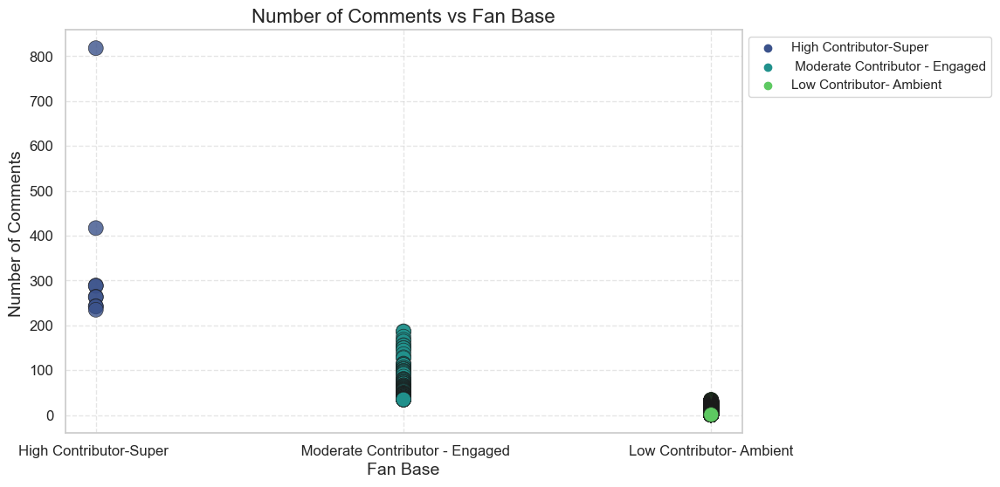

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set a style for better aesthetics (optional)
sns.set(style="whitegrid")

# Create a scatter plot with customizations
plt.figure(figsize=(10, 6))

# Use Seaborn's scatterplot to assign colors based on 'Contribution_Category'
scatter = sns.scatterplot(x='Contribution_Category', y='num_comments', hue='Contribution_Category', data=df, palette='viridis', s=150, alpha=0.8, edgecolor='k', linewidth=0.5, marker='o')

plt.xlabel('Fan Base', fontsize=14)
plt.ylabel('Number of Comments ', fontsize=14)
plt.title('Number of Comments vs Fan Base', fontsize=16)

# Add a grid (optional)
plt.grid(True, linestyle='--', alpha=0.5)

# Customize tick labels (optional)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Add a legend outside of the plot
legend = plt.legend( loc='upper left', bbox_to_anchor=(1, 1))
legend.get_title().set_fontsize(12)  # Adjust the legend title fontsize

# Increase the vibrancy of the colors




plt.show()


In [17]:
import ipywidgets as widgets
from IPython.display import display, clear_output

# Create a dropdown widget to select user IDs
user_dropdown = widgets.Dropdown(options=["Select User ID"] + list(grouped['User Id']), description='User ID:')


# user_container = widgets.HBox([user_dropdown, user_search])

# Create a search bar widget to search for user IDs
user_search = widgets.Text(placeholder='Search User ID', description='Search:')
search_output = widgets.Output()

# Create a range slider widget to select the comment count range
comment_count_range = widgets.IntRangeSlider(
    value=(1, 50),
    min=1,
    max=1000,
    step=50,
    continuous_update=False
)

# Create an output widget to display the selected user's comments
output = widgets.Output()

# Create a button widget to clear all widgets
clear_button = widgets.Button(description='Clear')



user_container = widgets.HBox([user_dropdown, user_search])
# Function to display comments for a selected user
def display_comments(selected_user):
    with output:
        clear_output(wait=True)
        if selected_user == "Select User ID":
            print("Please select or search for a user ID")
        else:
            selected_comments = grouped[grouped['User Id'] == selected_user]['Comment Text'].iloc[0]
            print(f"User ID: {selected_user}")
            print(f"Number of Comments: {len(selected_comments)}")
            print("\nComments:")
            for comment in selected_comments:
                print(comment)

# Function to handle search bar changes
def on_search_change(change):
    search_term = change['new']
    
    if search_term == "":
        matching_users = grouped
    else:
        matching_users = grouped[grouped['User Id'].astype(str).str.contains(search_term, case=False, na=False)]
    
    with search_output:
        clear_output(wait=True)
        for _, user_row in matching_users.iterrows():
            user_id = user_row['User Id']
            comments = user_row['Comment Text']
            
            print(f"User ID: {user_id}")
            print(f"Number of Comments: {len(comments)}")
            print("Comments:")
            for comment in comments:
                print(comment)
            print("-" * 20)

# Function to handle user selection changes
def on_user_selection(change):
    selected_user = change['new']
    display_comments(selected_user)

# Function to handle comment count range changes
def on_comment_count_change(change):
    min_count, max_count = change['new']
    filtered_users = grouped[(grouped['num_comments'] >= min_count) & (grouped['num_comments'] <= max_count)]
    with output:
        clear_output(wait=True)
        for index, row in filtered_users.iterrows():
            print(f"User ID: {row['User Id']}")
            print(f"Number of Comments: {row['num_comments']}")
            print("-" * 20)

# Function to clear all widgets
def clear_all_widgets(_):
    user_dropdown.value = "Select User ID"
    user_search.value = ""
    with search_output:
        clear_output(wait=True)
    comment_count_range.value = (1, 50)
    with output:
        clear_output(wait=True)

        
        
comment_count_vbox = widgets.VBox([
    widgets.Label('Comment Count Range:'),  # Description label
    comment_count_range  # The slider widget
])


# Assign widget event handlers
user_search.observe(on_search_change, names='value')
user_dropdown.observe(on_user_selection, names='value')
comment_count_range.observe(on_comment_count_change, names='value')
clear_button.on_click(clear_all_widgets)

# Display the widgets and clear button
display(user_container)
# display(user_dropdown)
# display(user_search)
# display(search_output)
# display(comment_count_range)
display(comment_count_vbox)
display(search_output)
display(output)

display(clear_button)  # Display the clear button
# display(comment_count_range)
# display(output)
# final 


Output()

Output()

Button(description='Clear', style=ButtonStyle())

## figure out the topic moddeling without the artist replies 

In [9]:
# outer_merged = pd.concate(merged_df_insta_without_reply, merged_df_fb_without_reply)

concatenated_df = pd.concat([merged_df_insta_without_reply, merged_df_fb_without_reply])

text_list = concatenated_df['Comment Text'].tolist()
text_list = concatenated_df['Comment Text'].apply(lambda x: str(x)).tolist()

text_list



['prettiest person on this planet',
 'miss u already',
 'I’m obsessed with u since Ed’s concert on Saturday 🤠',
 'Nice outfit, Mazzie',
 'you’ve slayed into next tuesday',
 'Wunderfull 😍',
 'I’m the gal with the blonde hair and sunglasses staring up like a proud mum🤦🏼\u200d♀️ iconic moment for here x',
 'Congratulations Maisie Peters 🎩👏👏👏',
 'Guuurl saw you live and you belong on the stage your performances are so powerful 🫶🎸',
 'Rocking those sunglasess, Rat! 💥',
 'ur so iconic stop',
 'The girl in the 2nd photo is such a boss🔥',
 'mazzie i just finished failing a chem midterm but glad to know my fave person is doing well <3',
 'i love u',
 'so proud of u <3',
 "Was a great show I still haven't edited my photos yet",
 '@laurenbhaduri  caught you at an “I need another beer” moment 🤣🤣',
 'You deserve it all so much 🙌❤️',
 '@yvettegabler @elly.jpeg op de derde foto zie je jullie (en mijn voorhoofd)',
 'How do u look like this',
 'Now that’s Gang$star 😎',
 'holy moly 😍',
 'I love u 😩',
 '

In [10]:

concatenated_df.to_csv('data.csv', index=False)

In [27]:
import gensim
from gensim import corpora
from gensim.models import LdaModel
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS

# Sample documents (replace with your own data)
documents = text_list

# Preprocess the documents
def preprocess(text):
    return [token for token in simple_preprocess(text) if token not in STOPWORDS]

processed_documents = [preprocess(doc) for doc in documents]

# Create a dictionary from the preprocessed documents
dictionary = corpora.Dictionary(processed_documents)

# Create a document-term matrix
doc_term_matrix = [dictionary.doc2bow(doc) for doc in processed_documents]

# Create an LDA model
num_topics =  10 # Specify the number of topics
lda_model = LdaModel(doc_term_matrix, num_topics=num_topics, id2word=dictionary, passes=15)

# Print the topics and associated words
for topic_num, topic_words in lda_model.print_topics():
    print(f"Topic #{topic_num + 1}: {topic_words}")

# Get the topic distribution for each document
for i, doc in enumerate(doc_term_matrix):
    print(f"Document {i + 1} - Topic Distribution: {lda_model.get_document_topics(doc)}")





import gensim
from gensim import corpora
from gensim.models import LdaModel
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
import pyLDAvis.gensim_models
import matplotlib.pyplot as plt

# Your code for preprocessing, creating LDA model, etc. (same as before)

# Visualize the LDA model
pyLDAvis.enable_notebook()  # If using Jupyter Notebook

# Create a visualization
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, dictionary)
pyLDAvis.display(vis)



Topic #1: 0.135*"wait" + 0.087*"excited" + 0.039*"girl" + 0.027*"way" + 0.021*"better" + 0.020*"hear" + 0.018*"im" + 0.017*"miss" + 0.015*"literally" + 0.015*"got"
Topic #2: 0.101*"album" + 0.053*"oh" + 0.045*"new" + 0.031*"god" + 0.026*"birthday" + 0.022*"gonna" + 0.017*"congratulations" + 0.017*"awesome" + 0.016*"slay" + 0.015*"song"
Topic #3: 0.043*"girls" + 0.043*"ll" + 0.041*"house" + 0.040*"coming" + 0.032*"release" + 0.028*"soon" + 0.022*"let" + 0.018*"number" + 0.018*"mp" + 0.017*"okay"
Topic #4: 0.049*"like" + 0.031*"know" + 0.027*"pls" + 0.026*"absolutely" + 0.025*"songs" + 0.021*"right" + 0.020*"night" + 0.019*"run" + 0.019*"come" + 0.019*"bestie"
Topic #5: 0.067*"need" + 0.054*"amazing" + 0.052*"good" + 0.049*"thank" + 0.031*"want" + 0.027*"got" + 0.024*"great" + 0.021*"queen" + 0.018*"xx" + 0.014*"man"
Topic #6: 0.127*"omg" + 0.081*"come" + 0.061*"yes" + 0.045*"crying" + 0.032*"ur" + 0.021*"screaming" + 0.020*"uk" + 0.015*"spain" + 0.015*"western" + 0.012*"brighton"
Topic 